In [2]:
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="5"

import numpy as np
import matplotlib.pyplot as plt
from ce_utils import load_data, one_hot, test_batch_idxs, batch_flatten
from ce_utils import model_prob
from ce_model import binary_model, ensemble_model

/usr/local/lib/python3.5/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.5/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.5/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.5/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 

In [59]:
redspot_img, redspot_name = load_data('test', 'hemorrhagic', 'red_spot')
angio_img, angio_name = load_data('test', 'hemorrhagic', 'angioectasia')
# active_img, active_name = load_data('test', 'hemorrhagic', 'active_bleeding')
# ero_img, ero_name = load_data('test', 'depressed', 'erosion')
# ulcer_img, ulcer_name = load_data('test', 'depressed', 'ulcer')
# str_img, str_name = load_data('test', 'depressed', 'stricture')

redspot_label = one_hot(redspot_img, 1)
angio_label = one_hot(angio_img, 1)
# active_label = one_hot(active_img, 1)
# ero_label = one_hot(ero_img, 1)
# ulcer_label = one_hot(ulcer_img, 1)
# str_label = one_hot(str_img, 1)

print("red spot:",redspot_img.shape, redspot_label.shape)
print("angioectasia:",angio_img.shape, angio_label.shape)
# print("active_bleeding:",active_img.shape, active_label.shape)
# print("erosion:",ero_img.shape, ero_label.shape)
# print("ulcer:",ulcer_img.shape, ulcer_label.shape)
# print("stricture:",str_img.shape, str_label.shape)

red spot: (1112, 512, 512, 3) (1112, 2)
angioectasia: (37, 512, 512, 3) (37, 2)


In [4]:
nh_path = './model/' + 'NH_1908312018_5750_val_acc_1.00_val_loss_0.001598'
# nd_path = './model/' + 'ND_1908302155_7140_val_acc_1.00_val_loss_0.002939'
# b_path = './model/' + 'NHD_1908242109_8570_val_acc_1.00_val_loss_0.011026'

NH_model = binary_model(nh_path)
# ND_model = binary_model(nd_path)
# E_model = ensemble_model(nh_path, nd_path)
# B_model = binary_model(b_path)

W1226 21:06:09.095465 140569173358336 deprecation_wrapper.py:119] From /mnt/disk1/project/SMhospital/capsule/algorithm/ensemble/ce_model.py:107: The name tf.Session is deprecated. Please use tf.compat.v1.Session instead.

W1226 21:06:11.619934 140569173358336 deprecation_wrapper.py:119] From /mnt/disk1/project/SMhospital/capsule/algorithm/ensemble/ce_model.py:108: The name tf.train.import_meta_graph is deprecated. Please use tf.compat.v1.train.import_meta_graph instead.

W1226 21:06:12.123492 140569173358336 deprecation.py:323] From /usr/local/lib/python3.5/dist-packages/tensorflow/python/training/saver.py:1276: checkpoint_exists (from tensorflow.python.training.checkpoint_management) is deprecated and will be removed in a future version.
Instructions for updating:
Use standard file APIs to check for files with this prefix.


# Grad-CAM

In [5]:
featuremap_list = ['conv2d/Relu:0', 'conv2d_1/Relu:0', 'maxp1/MaxPool:0', 
                    'conv2d_2/Relu:0', 'conv2d_3/Relu:0', 'maxp2/MaxPool:0', 
                    'conv2d_4/Relu:0', 'conv2d_5/Relu:0', 'maxp3/MaxPool:0', 
                    'conv2d_6/Relu:0', 'conv2d_7/Relu:0', 'maxp4/MaxPool:0', 
                    'conv2d_8/Relu:0', 'conv2d_9/Relu:0', 'maxp5/MaxPool:0', 
                    'conv2d_10/Relu:0', 'conv2d_11/Relu:0', 'maxp6/MaxPool:0', 
                    'conv2d_12/Relu:0', 'conv2d_13/Relu:0', 'maxp7/MaxPool:0']

## Red spot

In [57]:
batch_idxs = test_batch_idxs(redspot_img, batch_size = 10)

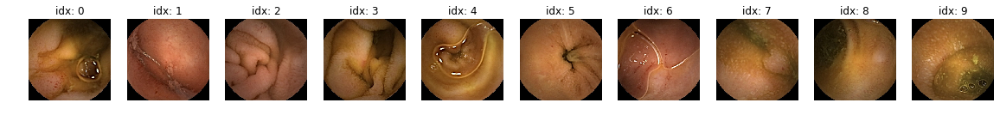

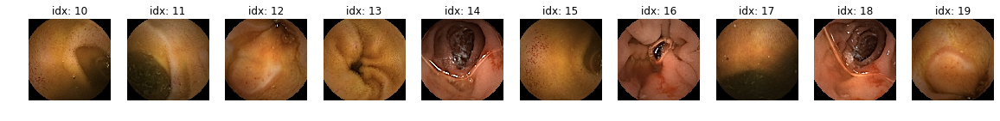

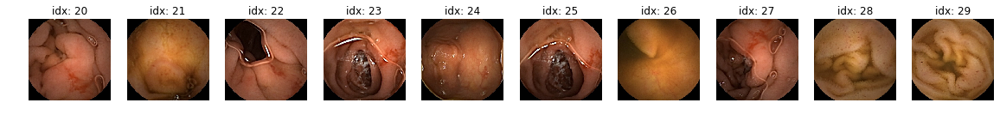

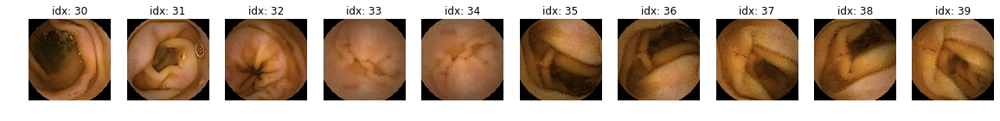

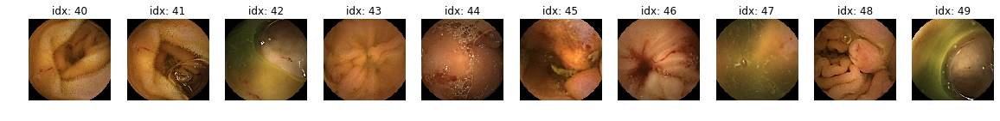

...

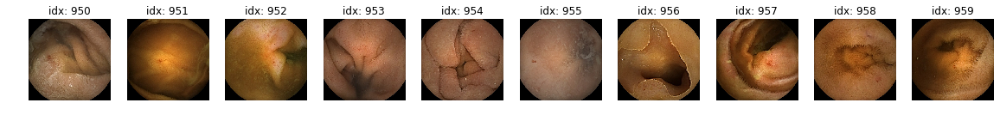

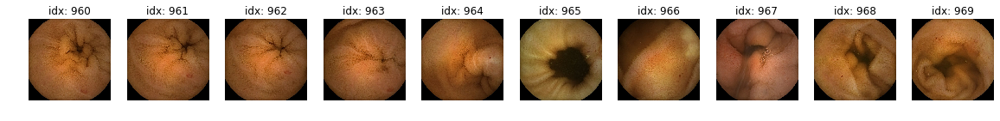

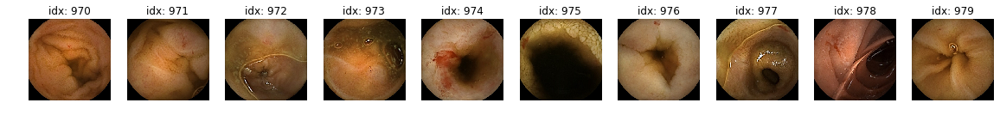

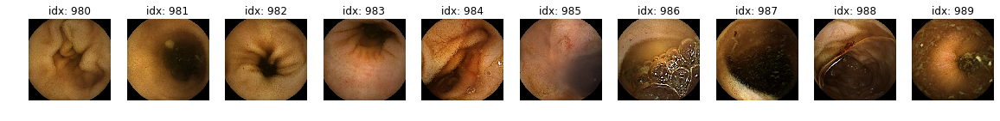

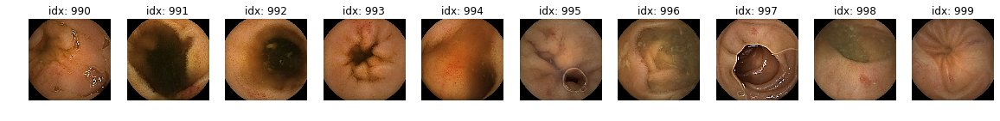

In [58]:
for b_idx in batch_idxs[:100]:
    plt.figure(figsize = (20, 5))
    for n, i in zip(range(1, len(b_idx)+1), b_idx):
        plt.subplot(1, 10, n)
        plt.title("idx: {}".format(i))
        plt.imshow(redspot_img[i])
        plt.axis('off')
    plt.show()

In [30]:
featuremap_list

['conv2d/Relu:0',
 'conv2d_1/Relu:0',
 'maxp1/MaxPool:0',
 'conv2d_2/Relu:0',
 'conv2d_3/Relu:0',
 'maxp2/MaxPool:0',
 'conv2d_4/Relu:0',
 'conv2d_5/Relu:0',
 'maxp3/MaxPool:0',
 'conv2d_6/Relu:0',
 'conv2d_7/Relu:0',
 'maxp4/MaxPool:0',
 'conv2d_8/Relu:0',
 'conv2d_9/Relu:0',
 'maxp5/MaxPool:0',
 'conv2d_10/Relu:0',
 'conv2d_11/Relu:0',
 'maxp6/MaxPool:0',
 'conv2d_12/Relu:0',
 'conv2d_13/Relu:0',
 'maxp7/MaxPool:0']

In [9]:
featuremap_list[-13:]

['maxp3/MaxPool:0',
 'conv2d_6/Relu:0',
 'conv2d_7/Relu:0',
 'maxp4/MaxPool:0',
 'conv2d_8/Relu:0',
 'conv2d_9/Relu:0',
 'maxp5/MaxPool:0',
 'conv2d_10/Relu:0',
 'conv2d_11/Relu:0',
 'maxp6/MaxPool:0',
 'conv2d_12/Relu:0',
 'conv2d_13/Relu:0',
 'maxp7/MaxPool:0']

In [32]:
maxp_list = []
for f in featuremap_list:
    if 'maxp' in f:
        maxp_list.append(f)

In [55]:
n = 360
# n = 54
n = 150

nh_cams = []

for f_n in maxp_list[-3:]:
    nh_cam = NH_model.get_gradcam(np.expand_dims(redspot_img[n], axis = 0), featuremap_name = f_n)
    nh_cams.append(nh_cam)
        
nh_cams = np.asarray(nh_cams)
nh_cams = np.squeeze(nh_cams, axis = 1)

In [51]:
maxp_list[-3:][i][:-10]

'maxp7'

54


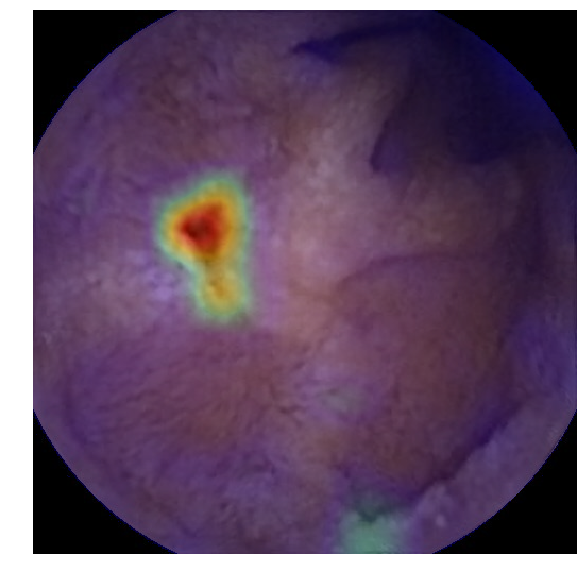

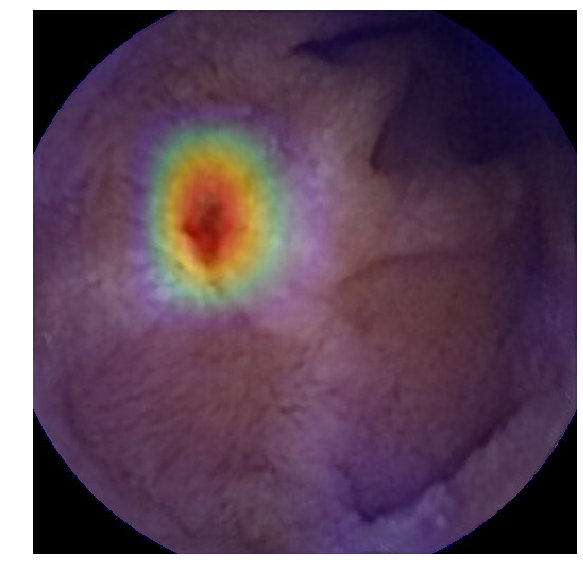

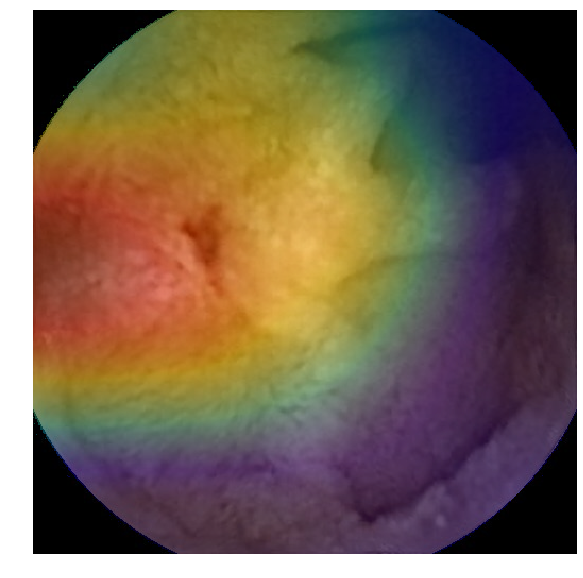

In [52]:
print(n)

for i in range(3):
    fig = plt.figure(figsize = (10, 10))
#     plt.title(maxp_list[-3:][i])
    plt.imshow(redspot_img[n])
    plt.imshow(nh_cams[i], alpha = 0.3)
    plt.axis('off')
    plt.show()
    fig.savefig('./redspot_{}_{}.png'.format(n, maxp_list[-3:][i][:-10]))

360


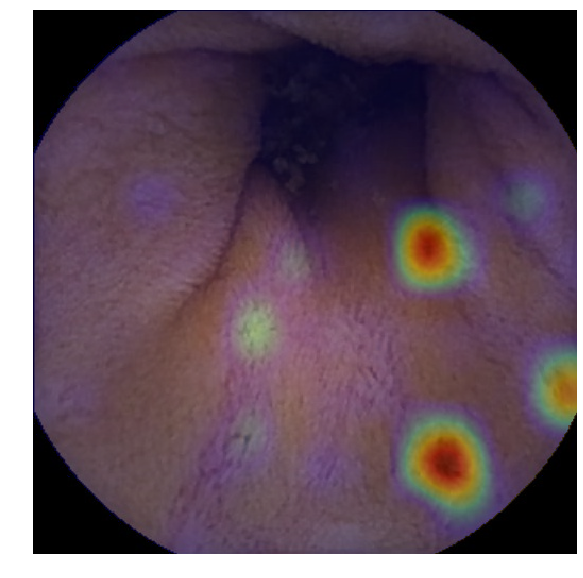

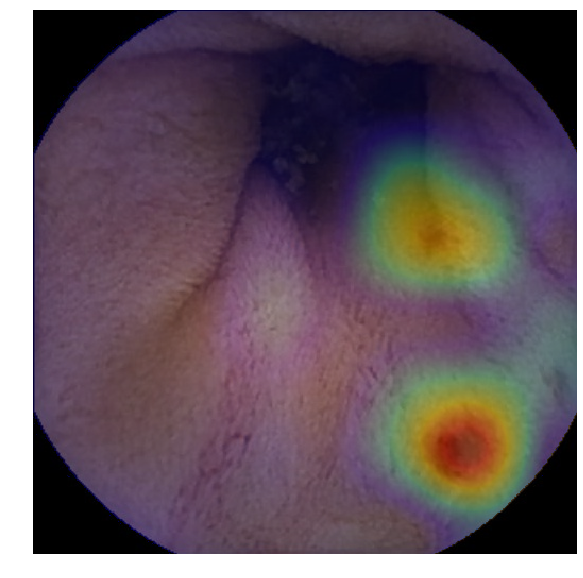

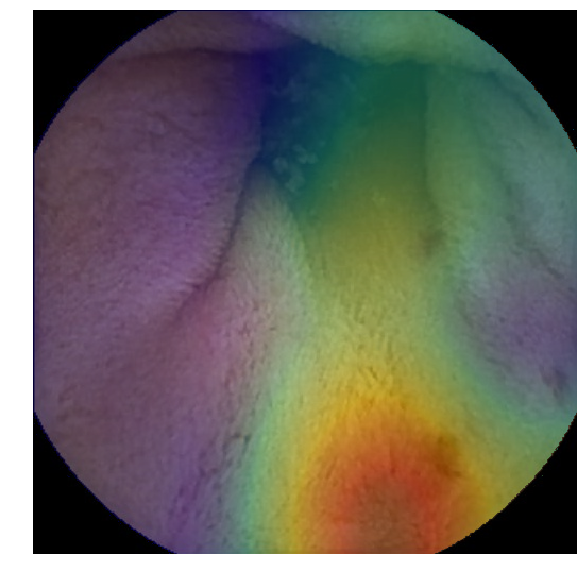

In [54]:
print(n)

for i in range(3):
    fig = plt.figure(figsize = (10, 10))
#     plt.title(maxp_list[-3:][i])
    plt.imshow(redspot_img[n])
    plt.imshow(nh_cams[i], alpha = 0.3)
    plt.axis('off')
    plt.show()
    fig.savefig('./redspot_{}_{}.png'.format(n, maxp_list[-3:][i][:-10]))

150


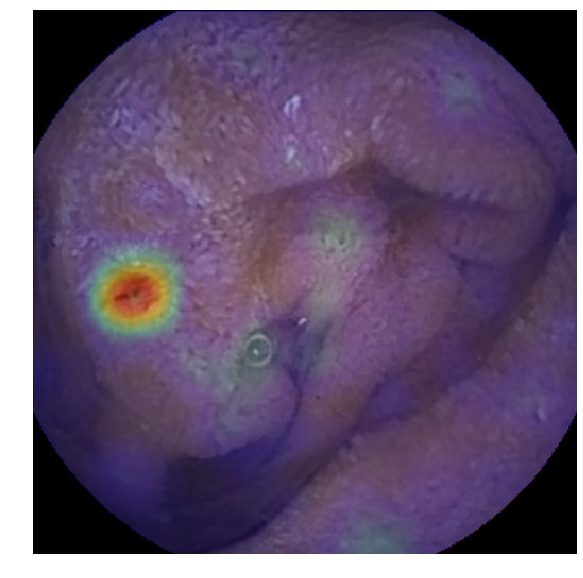

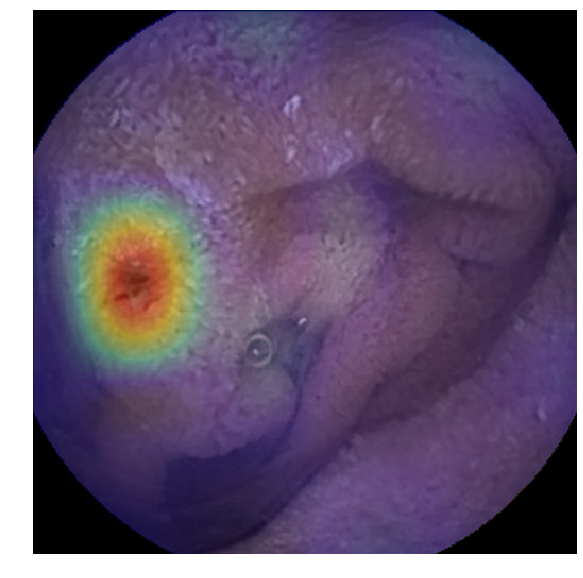

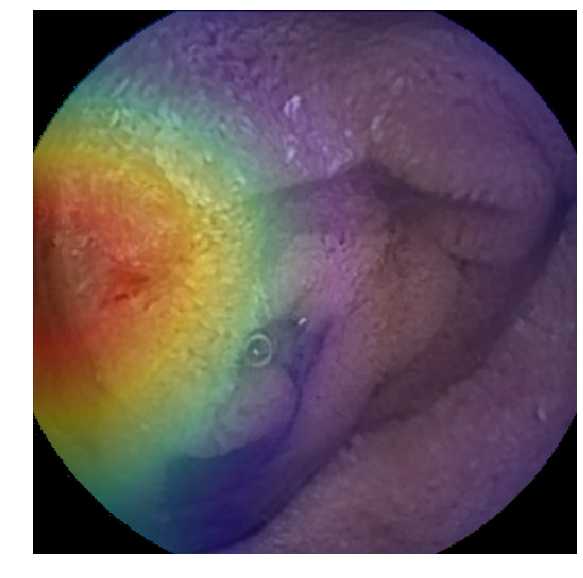

In [56]:
print(n)

for i in range(3):
    fig = plt.figure(figsize = (10, 10))
#     plt.title(maxp_list[-3:][i])
    plt.imshow(redspot_img[n])
    plt.imshow(nh_cams[i], alpha = 0.3)
    plt.axis('off')
    plt.show()
    fig.savefig('./redspot_{}_{}.png'.format(n, maxp_list[-3:][i][:-10]))

In [70]:
n = 54
nh_cams = []

for f_n in featuremap_list:
    nh_cam = NH_model.get_gradcam(np.expand_dims(redspot_img[n], axis = 0), featuremap_name = f_n)
    nh_cams.append(nh_cam)
        
nh_cams = np.asarray(nh_cams)
nh_cams = np.squeeze(nh_cams, axis = 1)

In [74]:
nh_cams.shape

(21, 512, 512, 3)

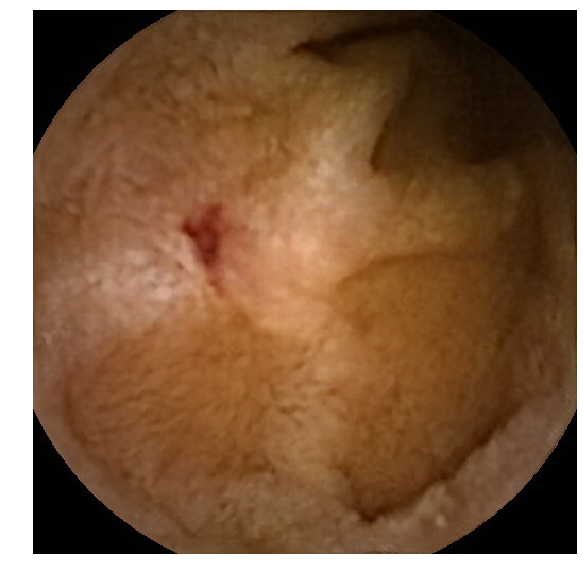

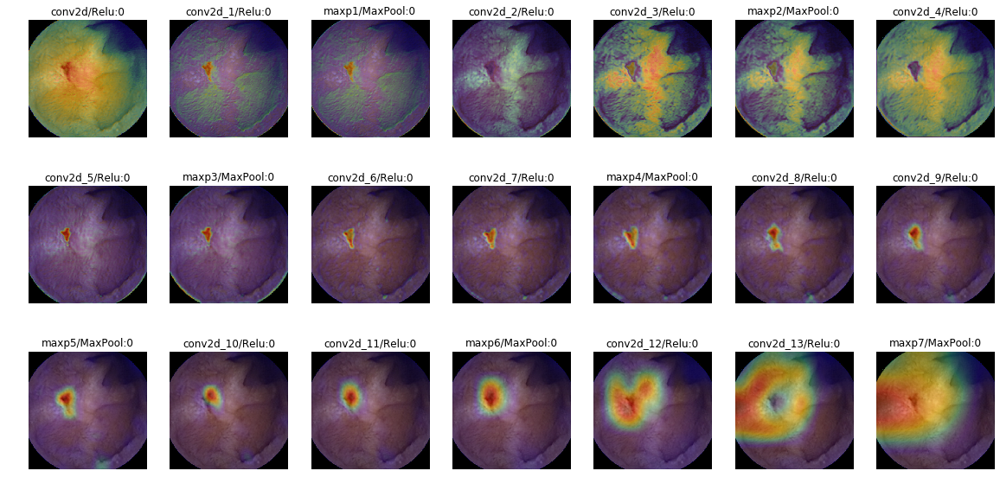

In [77]:
fig = plt.figure(figsize = (10, 10))
plt.imshow(redspot_img[n])
plt.axis('off')
fig.savefig('./redspot_{}.png'.format(n), dpi = 300)

fig = plt.figure(figsize = (20, 10))

for i, cam in zip(range(len(featuremap_list)), nh_cams):
    plt.subplot(3, 7, i+1)
    plt.title(featuremap_list[i])
    plt.imshow(redspot_img[n])
    plt.imshow(cam, alpha = 0.3)
    plt.axis('off')
fig.savefig('./gradcam_redspot_{}.png'.format(n), dpi = 300)

## Angioectasia

In [60]:
batch_idxs = test_batch_idxs(angio_img, batch_size = 10)

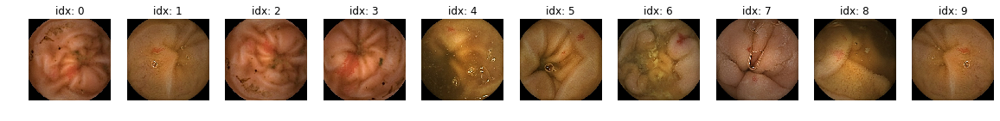

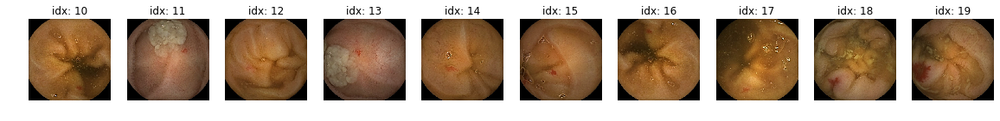

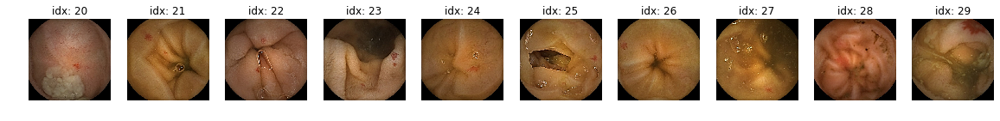

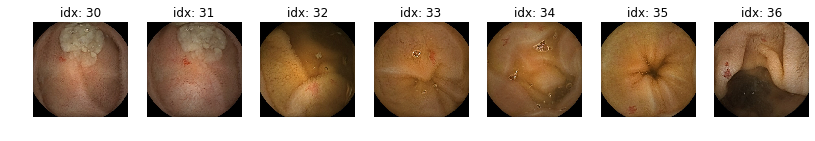

In [61]:
for b_idx in batch_idxs:
    plt.figure(figsize = (20, 5))
    for n, i in zip(range(1, len(b_idx)+1), b_idx):
        plt.subplot(1, 10, n)
        plt.title("idx: {}".format(i))
        plt.imshow(angio_img[i])
        plt.axis('off')
    plt.show()

In [68]:
n = 26

nh_cams = []

for f_n in maxp_list[-3:]:
    nh_cam = NH_model.get_gradcam(np.expand_dims(angio_img[n], axis = 0), featuremap_name = f_n)
    nh_cams.append(nh_cam)
        
nh_cams = np.asarray(nh_cams)
nh_cams = np.squeeze(nh_cams, axis = 1)

15


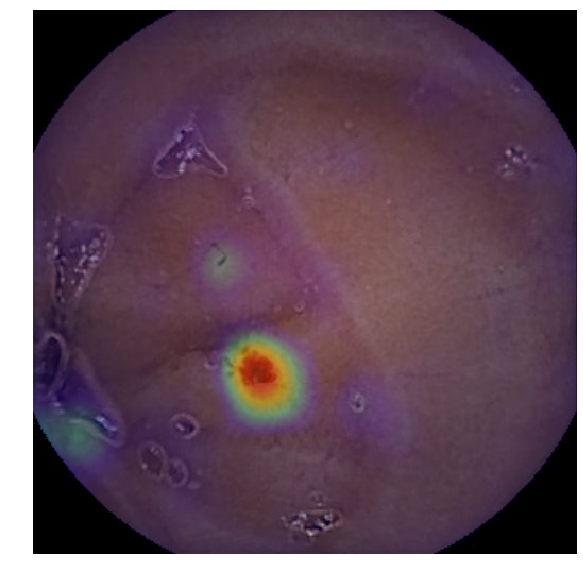

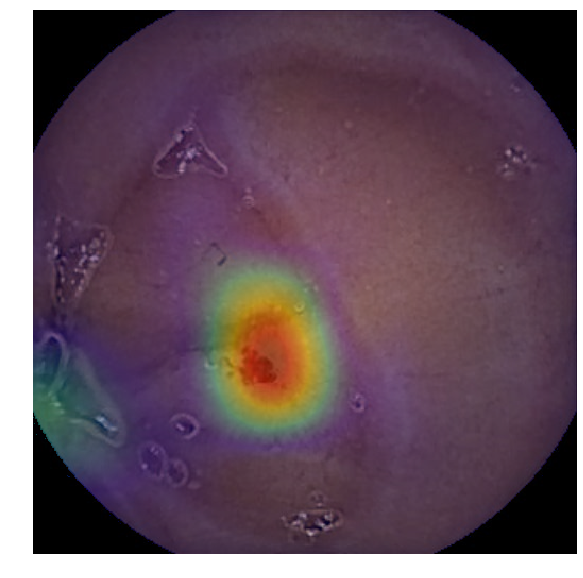

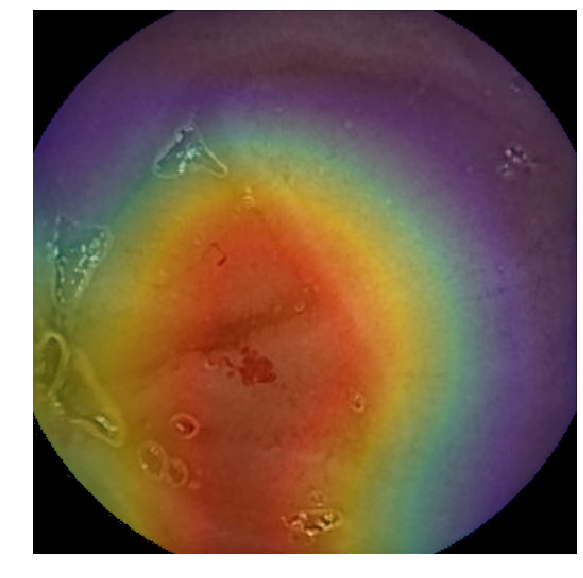

In [64]:
print(n)

for i in range(3):
    fig = plt.figure(figsize = (10, 10))
#     plt.title(maxp_list[-3:][i])
    plt.imshow(angio_img[n])
    plt.imshow(nh_cams[i], alpha = 0.3)
    plt.axis('off')
    plt.show()
    fig.savefig('./angio_{}_{}.png'.format(n, maxp_list[-3:][i][:-10]))

1


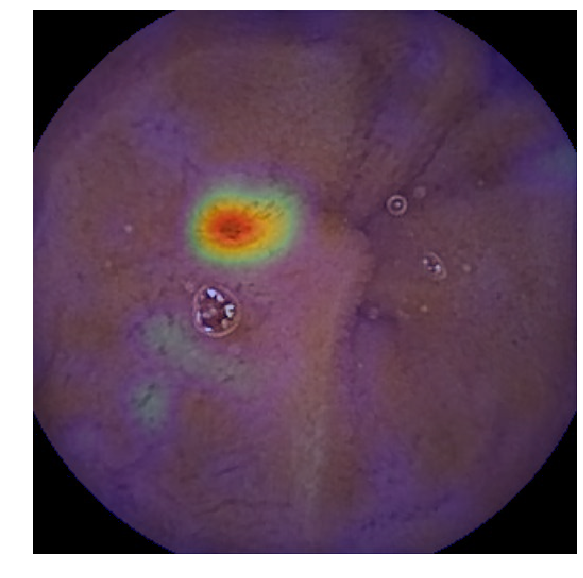

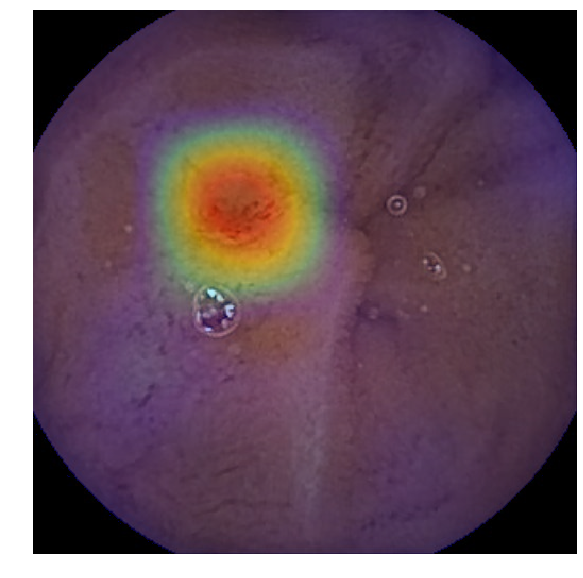

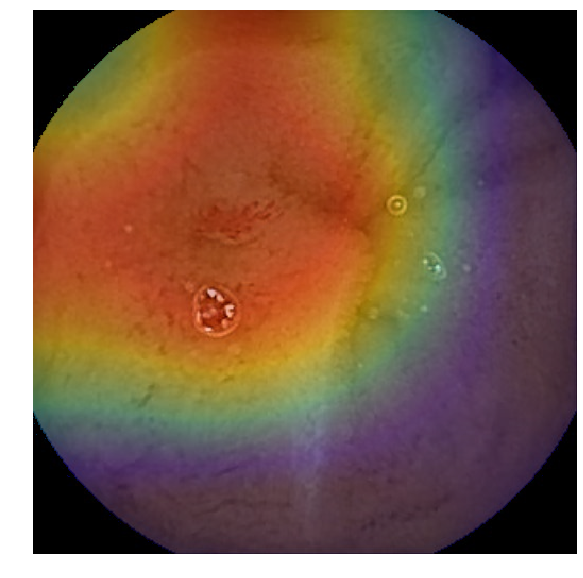

In [67]:
print(n)

for i in range(3):
    fig = plt.figure(figsize = (10, 10))
#     plt.title(maxp_list[-3:][i])
    plt.imshow(angio_img[n])
    plt.imshow(nh_cams[i], alpha = 0.3)
    plt.axis('off')
    plt.show()
    fig.savefig('./angio_{}_{}.png'.format(n, maxp_list[-3:][i][:-10]))

26


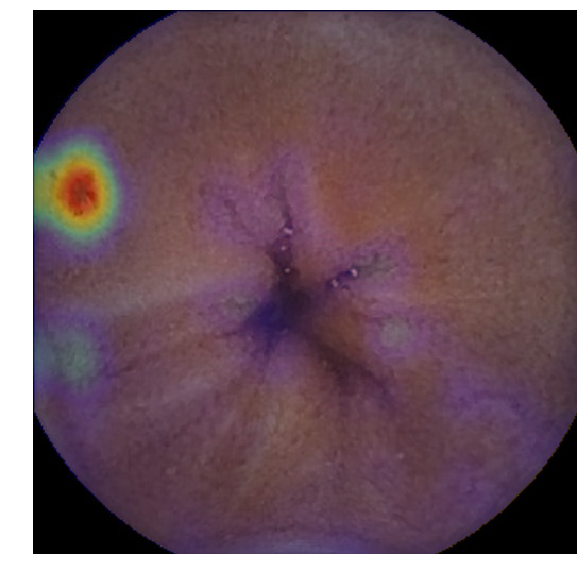

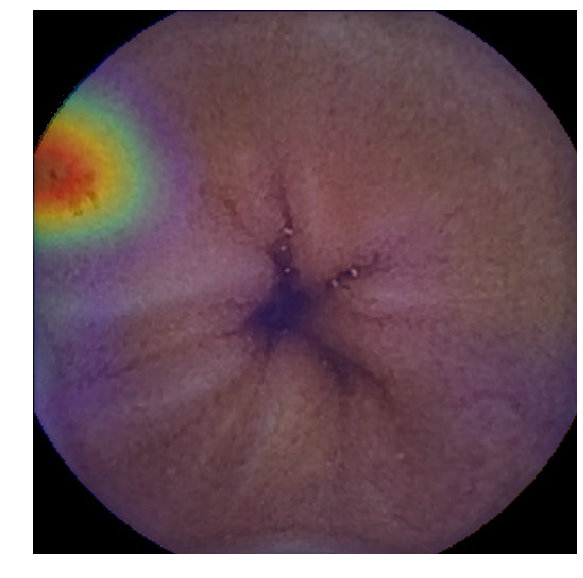

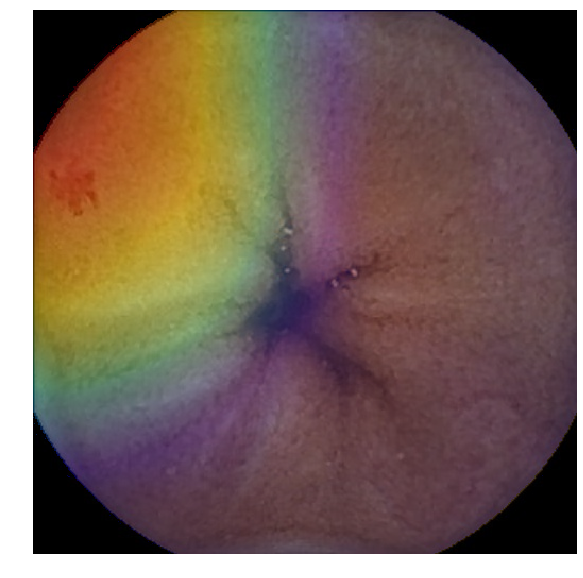

In [69]:
print(n)

for i in range(3):
    fig = plt.figure(figsize = (10, 10))
#     plt.title(maxp_list[-3:][i])
    plt.imshow(angio_img[n])
    plt.imshow(nh_cams[i], alpha = 0.3)
    plt.axis('off')
    plt.show()
    fig.savefig('./angio_{}_{}.png'.format(n, maxp_list[-3:][i][:-10]))

In [82]:
n = 21
nh_cams = []

for f_n in featuremap_list:
    nh_cam = NH_model.get_gradcam(np.expand_dims(angio_img[n], axis = 0), featuremap_name = f_n)
    nh_cams.append(nh_cam)
        
nh_cams = np.asarray(nh_cams)
nh_cams = np.squeeze(nh_cams, axis = 1)

36


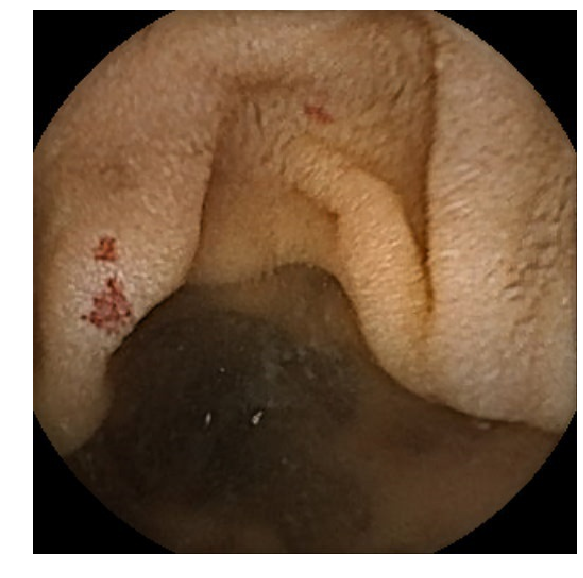

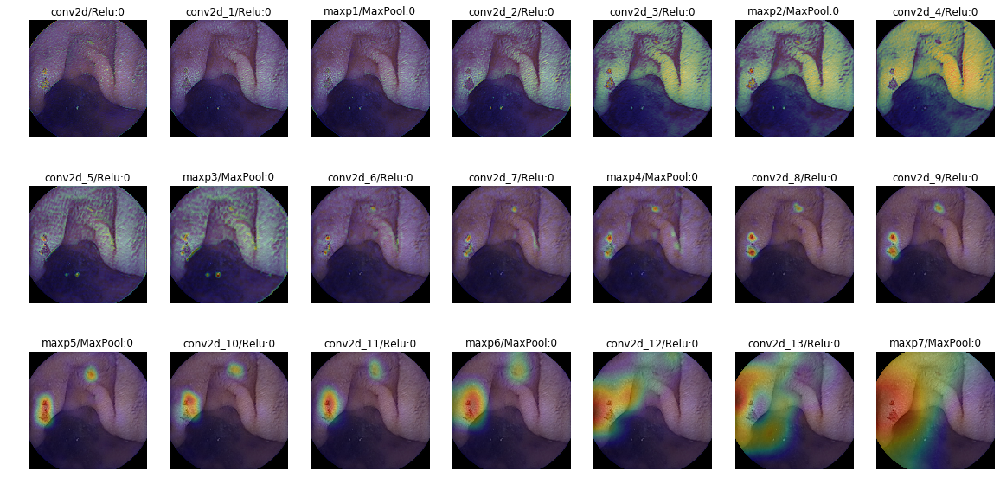

In [81]:
print(n)

fig = plt.figure(figsize = (10, 10))
plt.imshow(angio_img[n])
plt.axis('off')
# fig.savefig('./angio_{}.png'.format(n), dpi = 300)

fig = plt.figure(figsize = (20, 10))

for i, cam in zip(range(len(featuremap_list)), nh_cams):
    plt.subplot(3, 7, i+1)
    plt.title(featuremap_list[i])
    plt.imshow(angio_img[n])
    plt.imshow(cam, alpha = 0.3)
    plt.axis('off')
# fig.savefig('./gradcam_angio_{}.png'.format(n), dpi = 300)

21


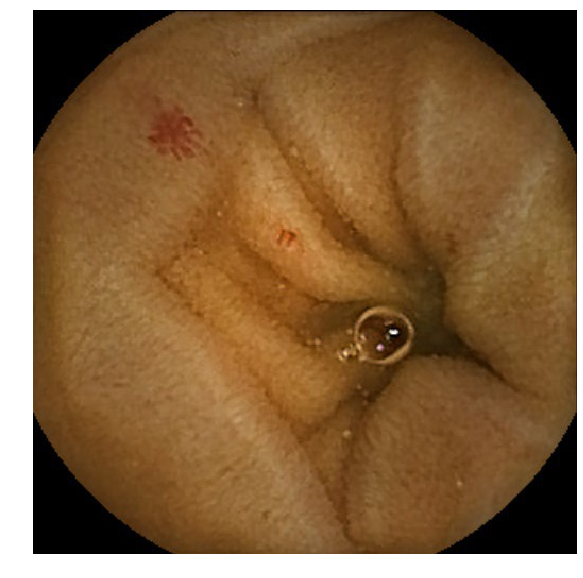

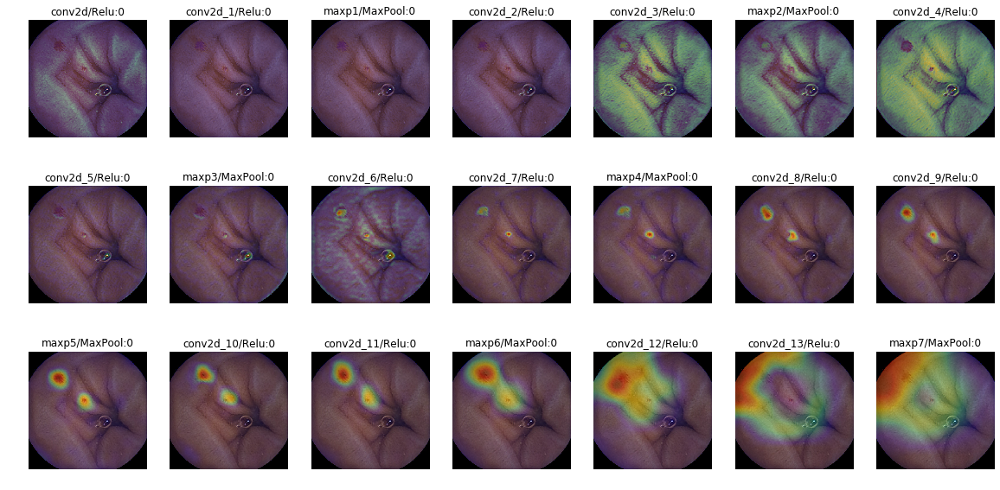

In [83]:
print(n)

fig = plt.figure(figsize = (10, 10))
plt.imshow(angio_img[n])
plt.axis('off')
# fig.savefig('./angio_{}.png'.format(n), dpi = 300)

fig = plt.figure(figsize = (20, 10))

for i, cam in zip(range(len(featuremap_list)), nh_cams):
    plt.subplot(3, 7, i+1)
    plt.title(featuremap_list[i])
    plt.imshow(angio_img[n])
    plt.imshow(cam, alpha = 0.3)
    plt.axis('off')
# fig.savefig('./gradcam_angio_{}.png'.format(n), dpi = 300)